In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/playground-series-s3e11/sample_submission.csv
/kaggle/input/playground-series-s3e11/train.csv
/kaggle/input/playground-series-s3e11/test.csv


In [2]:
train = pd.read_csv('/kaggle/input/playground-series-s3e11/train.csv')
test = pd.read_csv('/kaggle/input/playground-series-s3e11/test.csv')

In [3]:
train.head()

,id,store_sales(in millions),unit_sales(in millions),total_children,num_children_at_home,avg_cars_at home(approx).1,gross_weight,recyclable_package,low_fat,units_per_case,store_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
0,0,8.61,3.0,2.0,2.0,2.0,10.30,1.0,0.0,32.0,36509.0,0.0,0.0,0.0,0.0,0.0,62.09
1,1,5.00,2.0,4.0,0.0,3.0,6.66,1.0,0.0,1.0,28206.0,1.0,0.0,0.0,0.0,0.0,121.80
2,2,14.08,4.0,0.0,0.0,3.0,21.30,1.0,0.0,26.0,21215.0,1.0,0.0,0.0,0.0,0.0,83.51
3,3,4.02,3.0,5.0,0.0,0.0,14.80,0.0,1.0,36.0,21215.0,1.0,0.0,0.0,0.0,0.0,66.78
4,4,2.13,3.0,5.0,0.0,3.0,17.00,1.0,1.0,20.0,27694.0,1.0,1.0,1.0,1.0,1.0,111.51


In [4]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
id,360336.0,180167.500000,104020.187637,0.00,90083.75,180167.50,270251.25,360335.00
store_sales(in millions),360336.0,6.337376,3.307980,0.51,3.72,5.78,8.40,22.92
unit_sales(in millions),360336.0,3.043881,0.784676,1.00,3.00,3.00,4.00,6.00
total_children,360336.0,2.456482,1.488992,0.00,1.00,2.00,4.00,5.00
num_children_at_home,360336.0,0.689390,1.214732,0.00,0.00,0.00,1.00,5.00
avg_cars_at home(approx).1,360336.0,2.203813,1.084293,0.00,1.00,2.00,3.00,4.00
gross_weight,360336.0,13.822071,4.614792,6.00,9.71,13.60,17.70,21.90
recyclable_package,360336.0,0.568086,0.495343,0.00,0.00,1.00,1.00,1.00
low_fat,360336.0,0.327797,0.469411,0.00,0.00,0.00,1.00,1.00
units_per_case,360336.0,18.972706,10.212912,1.00,10.00,20.00,28.00,36.00


In [7]:
for cols in train.columns:
    print(f'{cols} , {train[cols].isna().sum().sum()}')

id , 0
store_sales(in millions) , 0
unit_sales(in millions) , 0
total_children , 0
num_children_at_home , 0
avg_cars_at home(approx).1 , 0
gross_weight , 0
recyclable_package , 0
low_fat , 0
units_per_case , 0
store_sqft , 0
coffee_bar , 0
video_store , 0
salad_bar , 0
prepared_food , 0
florist , 0
cost , 0


In [8]:
features = [c for c in train.columns if c not in ['id','cost']]

In [9]:
rows = 5
cols = 3
fig = make_subplots(rows=5, cols=3,horizontal_spacing = 0.05)
i = 0
for r in range(1,rows+1):
    for c in range(1,cols+1):
        fig.add_trace(go.Histogram(x=train[features[i]],name = features[i]),row=r, col=c)
        fig.update_xaxes(title_text=features[i], row=r, col=c)
        i = i+1
fig.update_layout(height = 800,showlegend=False)
fig.show()

In [10]:
def drawCorrelationMatrix(df):
    
    cmap = sns.diverging_palette(250, 15, s=75, l=40,
                                 n=9, center="light", as_cmap=True)
    matrix = df.corr()
    mask = np.triu(np.ones_like(matrix, dtype=bool))
    plt.figure(figsize=(16,12))
    plt.title("Correlation heatmap between all parameters")
#     sns.heatmap(corr, mask=mask, robust=True, center=0,square=True,fmt='.2f', linewidths=.6,cmap='YlOrRd_r')
    fig = sns.heatmap(matrix, robust = True,mask=mask, center=0,linewidths = 0.6, square=True, cmap=cmap)
    
def getRedundantPairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def getTopAbsCorrelations(df, n=5,method = 'pearson'):
#   ''' Get top 5 most correlated features in the given dataset. Method can be 'pearson', 'spearman', 'kendall' ''''
    au_corr = df.corr(method = method).abs().unstack()
    labels_to_drop = getRedundantPairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    print("Top {} Correlated features in given dataset".format(n))
    return au_corr[0:n]

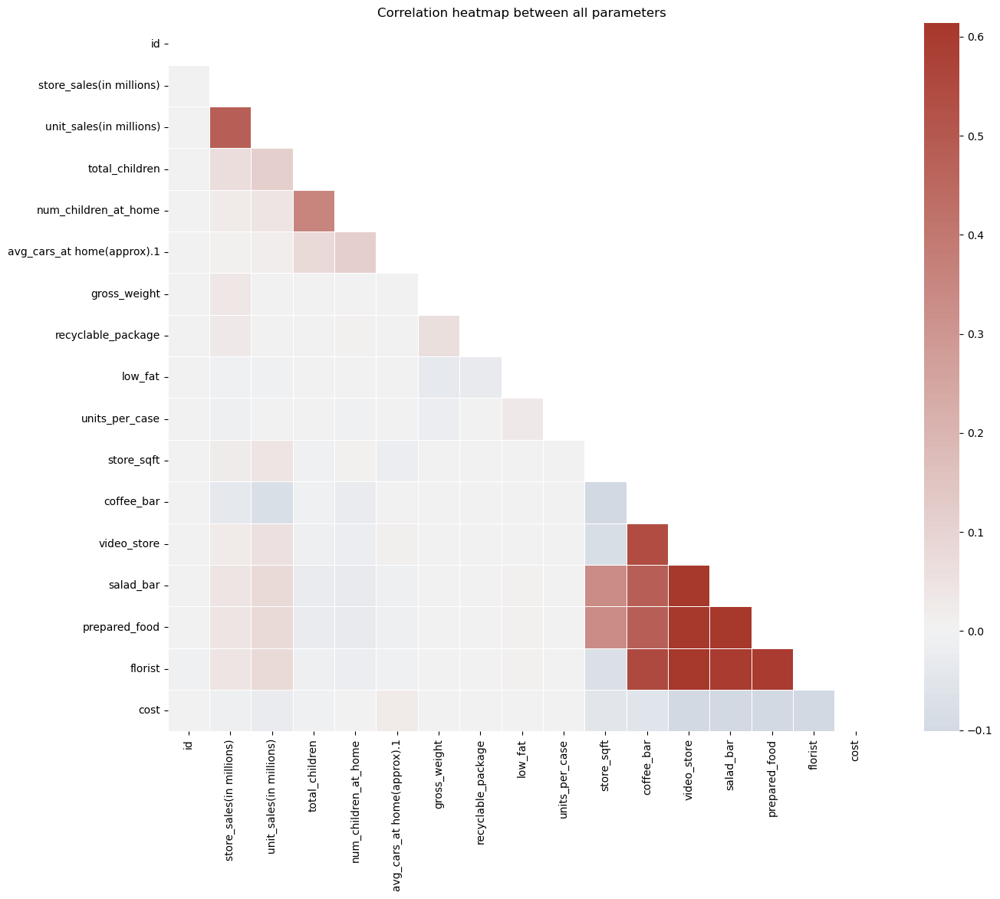

In [11]:
drawCorrelationMatrix(train)

In [12]:
getTopAbsCorrelations(train,n=5)

Top 5 Correlated features in given dataset


salad_bar    prepared_food    0.999839
video_store  florist          0.615465
             salad_bar        0.613640
             prepared_food    0.613609
salad_bar    florist          0.598653
dtype: float64

In [18]:
df_unique = {cols: len(train[cols].unique()) for cols in train.columns}
unique = pd.DataFrame.from_records([df_unique],index=["UniqueValues"])

In [19]:
unique.T

,UniqueValues
id,360336
store_sales(in millions),1044
unit_sales(in millions),6
total_children,6
num_children_at_home,6
avg_cars_at home(approx).1,5
gross_weight,384
recyclable_package,2
low_fat,2
units_per_case,36


In [20]:
categorical_features = [f for f in features if len(train[f].unique())<=6]
numerical_features = [f for f in features if f not in categorical_features]

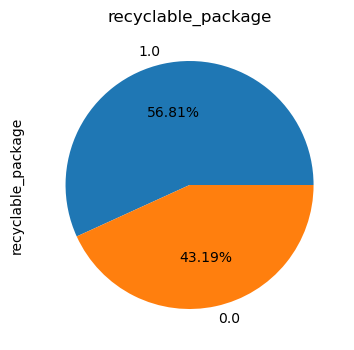

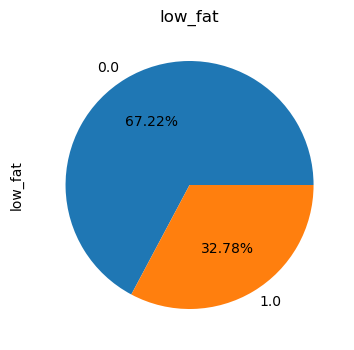

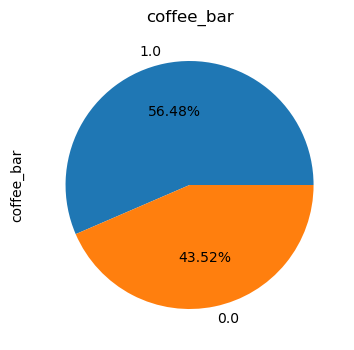

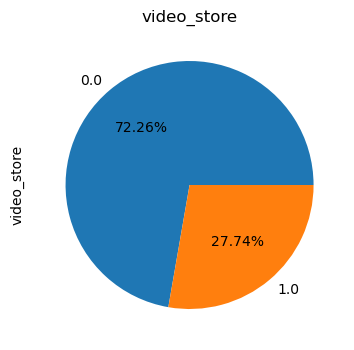

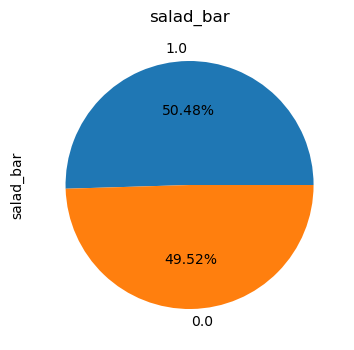

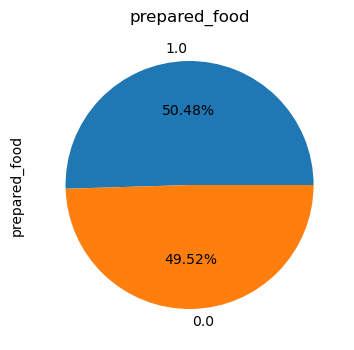

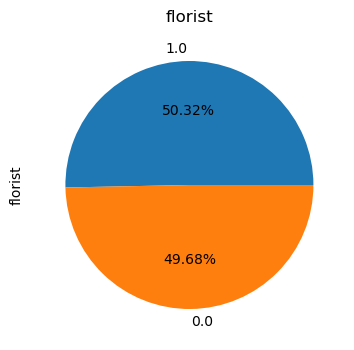

In [21]:
for f in categorical_features[4:]:
    plt.figure(figsize=(4,6))
    train[f].value_counts().plot.pie(autopct='%1.2f%%', textprops={'fontsize':10}).set_title(f)

In [22]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif,mutual_info_regression
def select_features(X_train, y_train, X_test):
    fs = SelectKBest(score_func=mutual_info_regression, k='all')
    fs.fit(X_train, y_train)
    X_train_fs = fs.transform(X_train)
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs

In [23]:
for col in categorical_features:
    train[col] = train[col].astype('category',copy=False)

In [24]:
X_train_fs, X_test_fs, fs = select_features(train[features], train['cost'], test[features])

for i in range(len(features)):
    print('%s: %f' % (features[i], fs.scores_[i]))

store_sales(in millions): 0.026536
unit_sales(in millions): 0.080908
total_children: 0.117045
num_children_at_home: 0.084192
avg_cars_at home(approx).1: 0.089859
gross_weight: 0.000071
recyclable_package: 0.000000
low_fat: 0.000000
units_per_case: 0.000388
store_sqft: 2.703681
coffee_bar: 0.594542
video_store: 0.519230
salad_bar: 0.608594
prepared_food: 0.609445
florist: 0.629548


In [25]:
import warnings
warnings.filterwarnings("ignore")

In [42]:
binaryGroups = (train.groupby(['coffee_bar','video_store','florist','prepared_food','salad_bar'], sort = True)
                    .agg(TotalAmountSpent=('cost', 'sum'), 
                    CountofCustomers=('cost', 'count'),
                    Avgrateofacquisition=('cost','mean'),
                    minCostofAcq = ('cost','min'),
                    maxCostofAcq = ('cost','max')).round(0)
                )



In [43]:
binaryGroups.reset_index(inplace=True)
binaryGroups = binaryGroups[binaryGroups['TotalAmountSpent']>0].sort_values(['TotalAmountSpent'],ascending = False).reset_index(drop=True)

In [50]:
for f in binaryGroups.columns:
    binaryGroups[f] = binaryGroups[f].astype('int32')

In [53]:
cols = ['TotalAmountSpent','CountofCustomers','Avgrateofacquisition','minCostofAcq','maxCostofAcq']
binaryGroups.style\
      .format('{:,.0f}')\
      .highlight_max(color = 'lightgreen')\
      .highlight_null(null_color='yellow')\
      .set_properties(**{'border': '1.3px solid black'})

,coffee_bar,video_store,florist,prepared_food,salad_bar,TotalAmountSpent,CountofCustomers,Avgrateofacquisition,minCostofAcq,maxCostofAcq
0,1,1,1,1,1,"9,440,011","99,940",94,51,150
1,0,0,0,0,0,"9,430,788","91,370",103,51,149
2,1,0,0,0,0,"5,380,611","51,192",105,51,148
3,1,0,1,1,1,"4,519,168","45,368",100,51,149
4,0,0,0,1,1,"3,567,838","36,026",99,51,149
5,0,0,1,0,0,"2,887,771","29,257",99,51,150
6,1,0,1,0,0,"607,178","6,597",92,51,147
7,1,0,0,1,1,"46,634",397,117,51,145
8,0,0,1,1,1,"11,602",145,80,51,147
9,1,1,0,1,1,"1,070",14,76,62,138


***Of the total amount spent for customer acquisition*,**
*     **Highest amount is spent on shops** with all the possible binary options such as with Coffee bar, with Video store,with Prepared food etc. 
*     Second Highest amount is spent on shops with none of the above options
*     If place had coffee bar, then considerable amount is spent on acquisition cost
*     Presence of video store didn't had a significant impact on customer acquisition cost

In [55]:
for f in features:
    train[f] = train[f].astype('int32')
    
train['amenities'] = train['coffee_bar']+train['video_store']+train['salad_bar']+train['prepared_food']+train['florist']
test['amenities'] = test['coffee_bar']+test['video_store']+test['salad_bar']+test['prepared_food']+test['florist']

train['children_store'] = 1 - (train['num_children_at_home']/train['total_children'])
test['children_store'] = 1 - (test['num_children_at_home']/test['total_children'])

features = [x for x in train.columns if x not in ['id', 'cost']]

<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

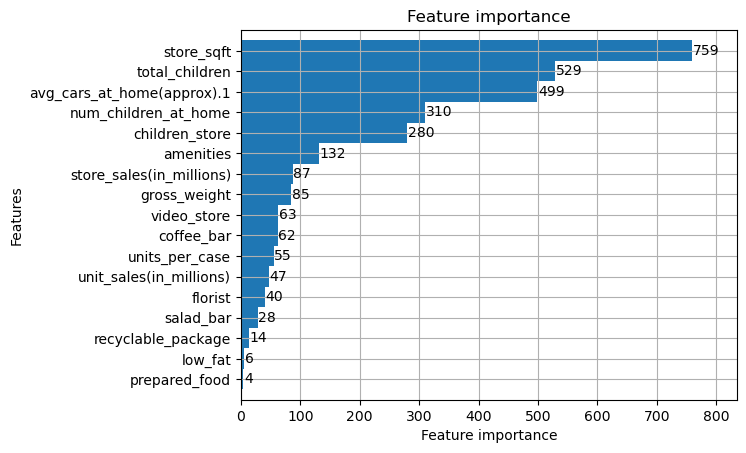

In [21]:
import lightgbm as lgb

X = train[features]
y = np.log(train['cost'])

lgbm_model = lgb.LGBMRegressor()
lgbm_model.fit(X, y)

lgb.plot_importance(lgbm_model, height=1)

In [22]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_log_error, make_scorer
from sklearn.model_selection import cross_val_score
from math import sqrt
rmlse = make_scorer(mean_squared_log_error, squared=False)

model1 = lgb.LGBMRegressor()
scores_select_feat = cross_val_score(model1, train[features], train['cost'], cv=10, scoring=rmlse)

print(f'RMLSE with selected features : {scores_select_feat.mean()}')

RMLSE with selected features : 0.3029219830966682


In [57]:
import xgboost as xgb

In [58]:
from sklearn.model_selection import train_test_split

In [59]:
X_train, X_test, y_train, y_test = train_test_split(train[features],train['cost'], test_size=0.33, random_state=42)

In [63]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_log_error
from xgboost import XGBRegressor

# Define XGBoost model
model = XGBRegressor()

# Define hyperparameters for tuning
params = {
    'learning_rate': [0.1],
    'max_depth': [10],
    'n_estimators': [31],
    'objective' : ['reg:squarederror'],
    'booster' : ['gbtree'],
    'min_child_weight': [0.285],
    'eval_metric' : ['rmse'],
    'reg_lambda': [6.66],
    'reg_alpha': [0.85],
    'subsample': [1],
    'colsample_bytree': [1],
    'seed': [42]
    
}

# Define GridSearchCV object
grid = GridSearchCV(estimator=model, param_grid=params, scoring='neg_mean_squared_log_error', cv=5)

# Fit the GridSearchCV object to the data
grid.fit(X_train, y_train)

# Print the best hyperparameters and score
print("Best score:", grid.best_score_)
print("Best parameters:", grid.best_params_)

# Use the best model to make predictions on the test set
y_pred = grid.predict(X_test)

# Calculate RMSLE
rmsle = mean_squared_log_error(y_test, y_pred, squared=False)
print('RMSLE:', rmsle)
#0.29954392637897637
#max8 0.29851271344925934

Best score: -0.08864622307417427
Best parameters: {'booster': 'gbtree', 'colsample_bytree': 1, 'eval_metric': 'rmse', 'learning_rate': 0.1, 'max_depth': 10, 'min_child_weight': 0.285, 'n_estimators': 31, 'objective': 'reg:squarederror', 'reg_alpha': 0.85, 'reg_lambda': 6.66, 'seed': 42, 'subsample': 1}
RMSLE: 0.29652396117841556


In [64]:
xg_model = grid.best_estimator_

testset = test.copy()
test_pred = xg_model.predict(testset[features])

In [65]:
submission = testset.loc[:, ["id"]]
submission["cost"] = test_pred

In [66]:
submission

,id,cost
0,360336,98.045563
1,360337,92.732689
2,360338,91.760971
3,360339,94.265251
4,360340,81.109894
...,...,...
240219,600555,99.056267
240220,600556,93.172638
240221,600557,94.359062
240222,600558,103.828140


In [68]:
submission.to_csv("xgbregressor1.csv",index=False)

In [ ]:
# y_true     = train["cost"]
# from sklearn.metrics import mean_squared_log_error
# RMSLE = np.sqrt( mean_squared_log_error(y_true, predictions) )
# print("The score is %.5f" % RMSLE )

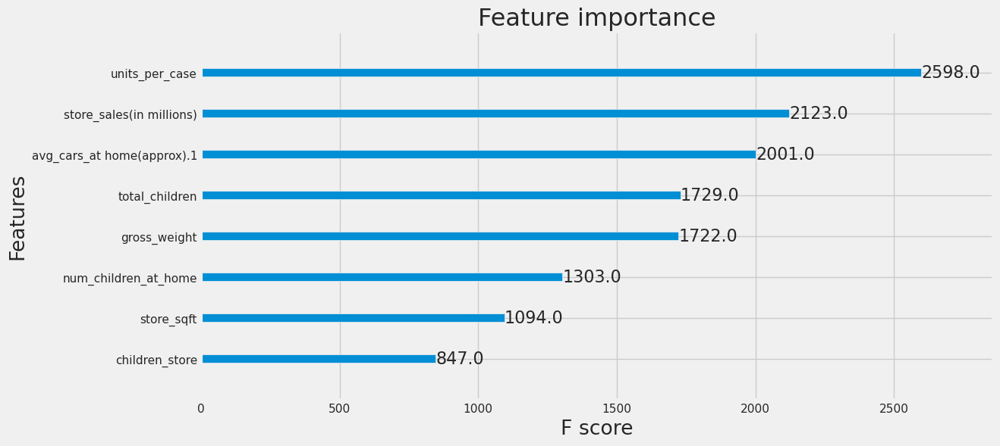

In [69]:
from xgboost import plot_importance
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(figsize=(12,6))
plot_importance(xg_model, max_num_features=8, ax=ax)
plt.show();

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [ ]:
from catboost import CatBoostRegressor
model = CatBoostRegressor(
    iterations = 10000,
    depth = 7,
    learning_rate = 0.04,
    l2_leaf_reg = 0.6169164517797081,
    random_strength = 0.21235850198764036,
    max_bin = 212,
    od_wait = 67,
    one_hot_max_size = 73,
    grow_policy = 'Depthwise',
    bootstrap_type = 'Bayesian',
    od_type = 'Iter',
    loss_function = 'RMSE',
    random_state = 42,
    verbose = 200
)

eval_set = (X_test, y_test)

model.fit(X_train, y_train, eval_set=eval_set)

y_pred = model.predict(X_test)

metrics = {
    'MSE': np.sqrt(mean_squared_error(y_test, y_pred)),
    'R^2': r2_score(y_test, y_pred),
    'Explained Variance': explained_variance_score(y_test, y_pred)
}

print('Regression Metrics:', metrics)

In [ ]:
y_train_pred = model.predict(X_train)
y_val_pred = model.predict(X_test)

# Calculate the mean squared error for the training and validation sets
mse_train = mean_squared_error(y_train, y_train_pred)
mse_val = mean_squared_error(y_test, y_val_pred)

# Plot the learning curves
train_scores = np.sqrt(model.evals_result_['learn']['RMSE'])
val_scores = np.sqrt(model.evals_result_['validation']['RMSE'])
plt.plot(train_scores, label='train')
plt.plot(val_scores, label='validation')
plt.xlabel('iteration')
plt.ylabel('RMSE')
plt.title('Learning curves')
plt.legend()
plt.show()

# Print the mean squared error for the training and validation sets
print(f"Mean squared error on training set: {mse_train:.2f}")
print(f"Mean squared error on validation set: {mse_val:.2f}")


In [ ]:
feature_importance = model.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(12, 6))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_test.columns)[sorted_idx])
plt.title('Feature Importance')

In [ ]:
sub_pred = model.predict(test)

submission = pd.DataFrame({'id':test['id'], 'cost': sub_pred})

submission.to_csv('submission.csv', index=False, header=True)